In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import os
import glob
import re
import matplotlib.pyplot as plt
import sys
import seaborn as sns
from plotnine import * 
import plotnine.options

In [2]:
sys.path.insert(1, '/secure/projects/HTAPP_MBC/src/')

In [3]:
from init_phase2 import * 

In [4]:
res_dir=baseDir+"/analysis/02_combined/"
os.makedirs(res_dir,exist_ok=True)

In [5]:
adata=sc.read_h5ad(out_dir+"/fresh_frozen_combined.h5ad")

In [6]:
adata.obs['cell_type']=pd.Categorical(adata.obs['cell_type'], categories=colors.index)
adata.obs['compartments']=pd.Categorical(adata.obs['compartments'], categories=["Malignant","Stromal","Lymphoid","Myeloid"])

In [6]:
pd.set_option('display.max_rows', 500)
adata.obs['name'].value_counts()

HTAPP-226-SMP-6757    23712
HTAPP-231-SMP-6758    21103
HTAPP-514-SMP-6760    20916
HTAPP-211-SMP-6751    16109
HTAPP-223-SMP-6755    14912
HTAPP-835-SMP-6999    13875
HTAPP-364-SMP-1321    13167
HTAPP-223-SMP-7537    12994
HTAPP-313-SMP-932     12494
HTAPP-232-SMP-6759    12431
HTAPP-997-SMP-7789    12258
HTAPP-752-SMP-4051    11704
HTAPP-889-SMP-7270    11655
HTAPP-862-SMP-7059    11432
HTAPP-889-SMP-7269    11100
HTAPP-908-SMP-4412    11087
HTAPP-917-SMP-4531    11074
HTAPP-890-SMP-7299    11064
HTAPP-880-SMP-7179    10918
HTAPP-814-SMP-6879    10875
HTAPP-878-SMP-7149    10623
HTAPP-947-SMP-7509    10503
HTAPP-759-SMP-8359    10423
HTAPP-887-SMP-7239    10361
HTAPP-611-SMP-3062    10277
HTAPP-862-SMP-7060    10167
HTAPP-944-SMP-7479    10016
HTAPP-895-SMP-7359     9958
HTAPP-589-SMP-2860     9935
HTAPP-213-SMP-6752     9799
HTAPP-806-SMP-6789     9497
HTAPP-662-SMP-3602     9366
HTAPP-521-SMP-6763     9050
HTAPP-873-SMP-7119     8200
HTAPP-870-SMP-7089     8069
HTAPP-963-SMP-4741  

### Create Stats

In [13]:
adata.obs

,batch,cell_id,name,condition,replicate,orig.ident,nCount_RNA,nFeature_RNA,percent.mito,RNA_snn_res.0.8,seurat_clusters,labels,labels_score,labels_unif,labels_cl,labels_cl_unif,ccpm,Quality,Order,run status,Note,date,run_pipeline,Channel Name,Lane,Index,cancer,site,reference,chemistry,flowcell,seq_dir,mode,min_umis,min_genes,percent_mito,expected_cells,total_droplets,z_dim,z_layers,channel_id,label_concordance,labels_cl_unif_per_channel,filt_median_genes,filt_median_umi,pass,ccpm_id,ccpm_id_long,sample,htapp,...,cnv_score,cnv_ref_score,cnv_score_norm,cnv_score_norm_norm,cnv_max_cluster,cnv_condition,cnv_mode,cnv_score_norm_norm2,cnv_cell_type,cnv_pass,cnv_pass_mal,pam50_cellid,pam50_Basal_single,pam50_Her2_single,pam50_LumA_single,pam50_LumB_single,pam50_Normal_single,pam50_mode_single,pam50_subtype_single,pam50_subtype_prob_single,pam50_subtype_filt_single,pam50_Basal_cluster,pam50_Her2_cluster,pam50_LumA_cluster,pam50_LumB_cluster,pam50_Normal_cluster,pam50_mode_cluster,pam50_subtype_cluster,pam50_subtype_prob_cluster,pam50_subtype_filt_cluster,S.Score,G2M.Score,Phase,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,n_counts,leiden,leiden_mal,labels_cl_unif2_mal,labels_cl_unif2,labels_cl_unif2_broad,named_cluster,concat,named_cluster_split,compartments,select_cell,cell_type,harmony_leiden
cellid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
HTAPP-225-SMP-6756-TST-channel1_TGCATCCAGTTGCTGT-1-sn,sn,HTAPP-225-SMP-6756-TST-channel1_TGCATCCAGTTGCT...,HTAPP-225-SMP-6756,TST,channel1,HTAPP-225-SMP-6756-TST-channel1,14400,6364,2.847222,20,20,Epithelial cells,0.323041,Epithelial,Epithelial cells,Epithelial,0300260_T2_TST,nan,65,done1,nan,2019_05_28,False,0300260_T2_TST,5,SI-GA-C11,breast,liver,GRCh38_premrna_v3.0.0,SC3Pv3,HY3CLCCXY,/transfer/190522_SL-HYB_0503_BFC...,V3,0,0,60,4000,30000,200,1000,HTAPP-225-SMP-6756_TST_channel1,True,2209,1548.0,2076.0,True,260.0,300260,T2,HTAPP,...,0.002542,0.000932,2.726558,0.471278,Epithelial_1,TST,V3,0.471278,Epithelial,False,False,HTAPP-225-SMP-6756-TST-channel1_TGCATCCAGTTGCT...,0.563223,0.0,0.000000,0.000000,0.436777,single,Basal,0.563223,unknown,0.316631,0.000000,0.082360,0.000000,0.601010,cluster,Normal,0.601010,Normal,-0.023068,-0.027751,G1,6373,14409.0,410.0,2.845444,14347.0,43,56_False,Epithelial,Epithelial,Epithelial,Epithelial_56,Epithelial_Epithelial,Epithelial,Malignant,True,MBC,57
HTAPP-225-SMP-6756-TST-channel1_TGCAGTATCCTGCCAT-1-sn,sn,HTAPP-225-SMP-6756-TST-channel1_TGCAGTATCCTGCC...,HTAPP-225-SMP-6756,TST,channel1,HTAPP-225-SMP-6756-TST-channel1,13243,7599,0.415314,3,3,Adipocytes,0.431238,Adipocytes,Endothelial cells,Endothelial,0300260_T2_TST,nan,65,done1,nan,2019_05_28,False,0300260_T2_TST,5,SI-GA-C11,breast,liver,GRCh38_premrna_v3.0.0,SC3Pv3,HY3CLCCXY,/transfer/190522_SL-HYB_0503_BFC...,V3,0,0,60,4000,30000,200,1000,HTAPP-225-SMP-6756_TST_channel1,False,800,1734.0,2150.0,True,260.0,300260,T2,HTAPP,...,0.000835,0.000932,0.895210,0.154735,Epithelial_1,TST,V3,0.154735,Endothelial,False,False,HTAPP-225-SMP-6756-TST-channel1_TGCAGTATCCTGCC...,0.000000,0.0,0.883686,0.031722,0.084592,single,LumA,0.883686,LumA,0.000000,0.086341,0.450694,0.462965,0.000000,cluster,LumB,0.462965,unknown,-0.036614,-0.058505,G1,7608,13252.0,55.0,0.415032,13177.0,4,3_False,Endothelial,Endothelial,Endothelial,Endothelial_3,Endothelial_Endothelial,Endothelial_3,Stromal,True,Endothelial_vascular,4
HTAPP-225-SMP-6756-TST-channel1_TCACGCTAGCATGTTC-1-sn,sn,HTAPP-225-SMP-6756-TST-channel1_TCACGCTAGCATGT...,HTAPP-225-SMP-6756,TST,channel1,HTAPP-225-SMP-6756-TST-channel1,12393,5916,2.315823,13,13,Epithelial cells,0.325782,Epithelial,Epithelial cells,Epithelial,0300260_T2_TST,nan,65,done1,nan,2019_05_28,False,0300260_T2_TST,5,SI-GA-C11,breast,liver,GRCh38_premrna_v3.0.0,SC3Pv3,HY3CLCCXY,/transfer/190522_SL-HYB_0503_BFC...,V3,0,0,60,4000,30000,200,1000,HTAPP-225-SMP-6756_TST_channel1,True,2209,1548.0,2076.0,True,260.0,300260,T2,HTAPP,...,0.005394,0.00093

In [34]:
stats=adata.obs.groupby(['name','ccpmID','condition'],as_index=False,observed=True).agg({'nCount_RNA': ['mean','median', 'min', 'max'],
                                 'nFeature_RNA': ['mean','median', 'min', 'max'],
                                'cell_id' : ['count']},)
stats.columns=stats.columns.to_flat_index().str.join("")

In [35]:
stats.iloc[1:5,:]

,name,ccpmID,condition,nCount_RNAmean,nCount_RNAmedian,nCount_RNAmin,nCount_RNAmax,nFeature_RNAmean,nFeature_RNAmedian,nFeature_RNAmin,nFeature_RNAmax,cell_idcount
1,HTAPP-589-SMP-2860,0300294T2,TST,5304.155410,4420.0,304,19808,2961.499346,2864.0,160,7973,9935
2,HTAPP-589-SMP-2851,0300294T3,TST,2667.445012,2118.0,312,19579,1895.530738,1682.0,101,7904,7629
3,HTAPP-231-SMP-6758,0300360T1,TST,2307.657869,1707.0,301,19744,1656.089371,1390.0,233,7994,21103
4,HTAPP-862-SMP-7059,0300376T2,TST,5213.105143,4605.5,334,19967,3179.571029,3122.0,269,7806,11432


In [32]:
stats.to_csv(out_dir+"/sc_sn_stats.tsv",sep="\t")

### Create pseudobulk

In [14]:
samples=adata.obs['name'].unique()
bulk=pd.DataFrame(columns=samples)
bulk_mal=pd.DataFrame(columns=samples)
bulk_strom=pd.DataFrame(columns=samples)
bulk_lym=pd.DataFrame(columns=samples)
bulk_myel=pd.DataFrame(columns=samples)
for sample in samples:
    import warnings
    with warnings.catch_warnings():
        warnings.filterwarnings("ignore", message="is_categorical is deprecated and will be removed in a future version.")
        atmp=adata[adata.obs['name']==sample]
        bulk.loc[:,sample]=atmp.obsm['counts'].sum(axis=0).A.T.flatten()
        bulk_mal.loc[:,sample]=atmp[atmp.obs['compartments']=='Malignant'].obsm['counts'].sum(axis=0).A.T.flatten()
        bulk_strom.loc[:,sample]=atmp[atmp.obs['compartments']=='Stromal'].obsm['counts'].sum(axis=0).A.T.flatten()
        bulk_lym.loc[:,sample]=atmp[atmp.obs['compartments']=='Lymphoid'].obsm['counts'].sum(axis=0).A.T.flatten()
        bulk_myel.loc[:,sample]=atmp[atmp.obs['compartments']=='Myeloid'].obsm['counts'].sum(axis=0).A.T.flatten()
bulk.index=adata.raw.var.index
bulk_mal.index=adata.raw.var.index
bulk_strom.index=adata.raw.var.index
bulk_lym.index=adata.raw.var.index
bulk_myel.index=adata.raw.var.index

In [12]:
annot=adata.obs.loc[:,['name','condition','mode','ER_biopsy','PR_biopsy','HER2_biopsy','receptors_primary', 'receptors_biopsy',
                       'site_biopsy','biopsy_days_after_dob', 'biopsy_days_after_diagnosis','biopsy_days_after_metastasis']].drop_duplicates().reset_index(drop=True)

In [15]:
bulk.to_csv(out_dir+"/pseudobulk_counts.tsv",sep="\t")
bulk_mal.to_csv(out_dir+"/pseudobulk_counts_mal.tsv",sep="\t")
bulk_strom.to_csv(out_dir+"/pseudobulk_counts_strom.tsv",sep="\t")
bulk_lym.to_csv(out_dir+"/pseudobulk_counts_lym.tsv",sep="\t")
bulk_myel.to_csv(out_dir+"/pseudobulk_counts_myel.tsv",sep="\t")
annot.to_csv(out_dir+"/pseudobulk_annot.tsv",sep="\t")

### Look at the data

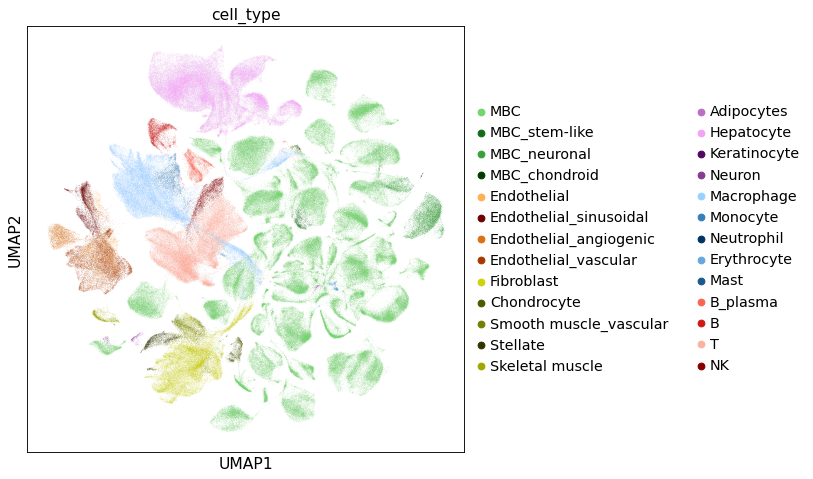

In [11]:
plt.rcParams['figure.figsize'] = [7, 7]
fig=sc.pl.umap(adata, color=['cell_type'],palette=colors.values.tolist(),return_fig=True)
fig.savefig(res_dir+"combined_UMAP_ct"+".pdf",bbox_inches="tight")

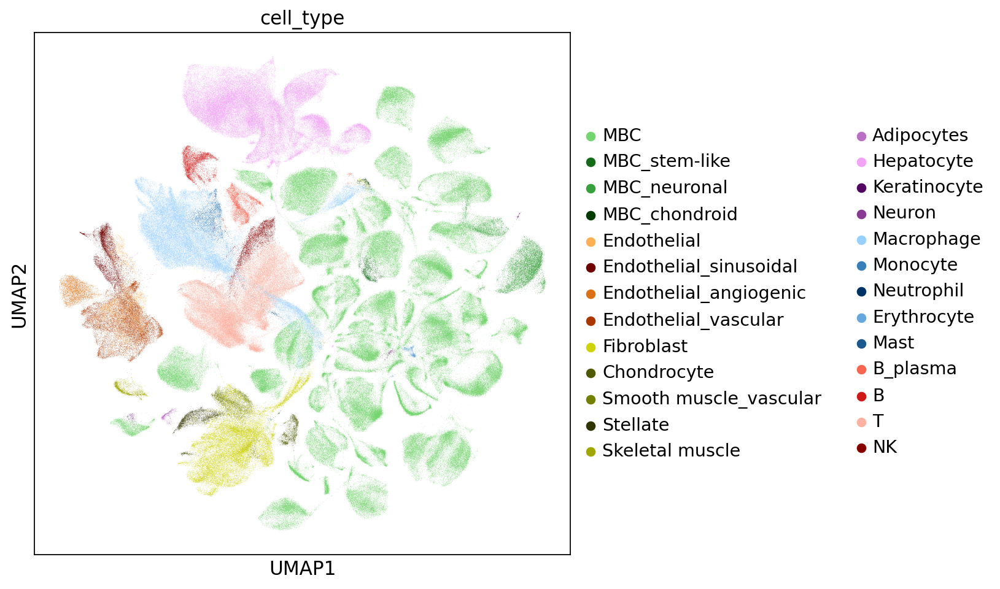

In [10]:
plt.rcParams['figure.figsize'] = [7, 7]
fig=sc.pl.umap(adata, color=['cell_type'],palette=colors.values.tolist(),return_fig=True)
fig.savefig(res_dir+cacheName+"_UMAP_mode"+".pdf",bbox_inches="tight")

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


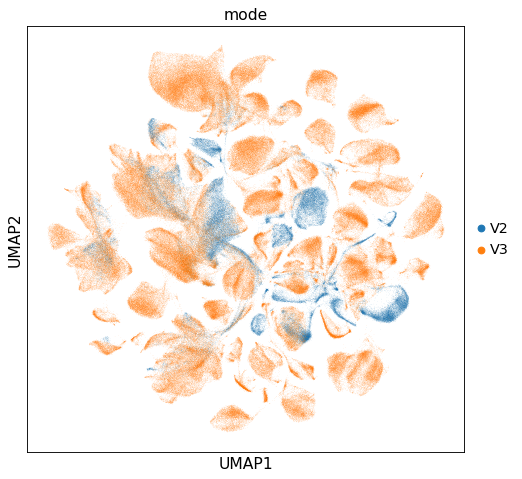

In [12]:
plt.rcParams['figure.figsize'] = [7, 7]
fig=sc.pl.umap(adata, color=['mode'],return_fig=True)
fig.savefig(res_dir+"combined_UMAP_mode"+".pdf",bbox_inches="tight")

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


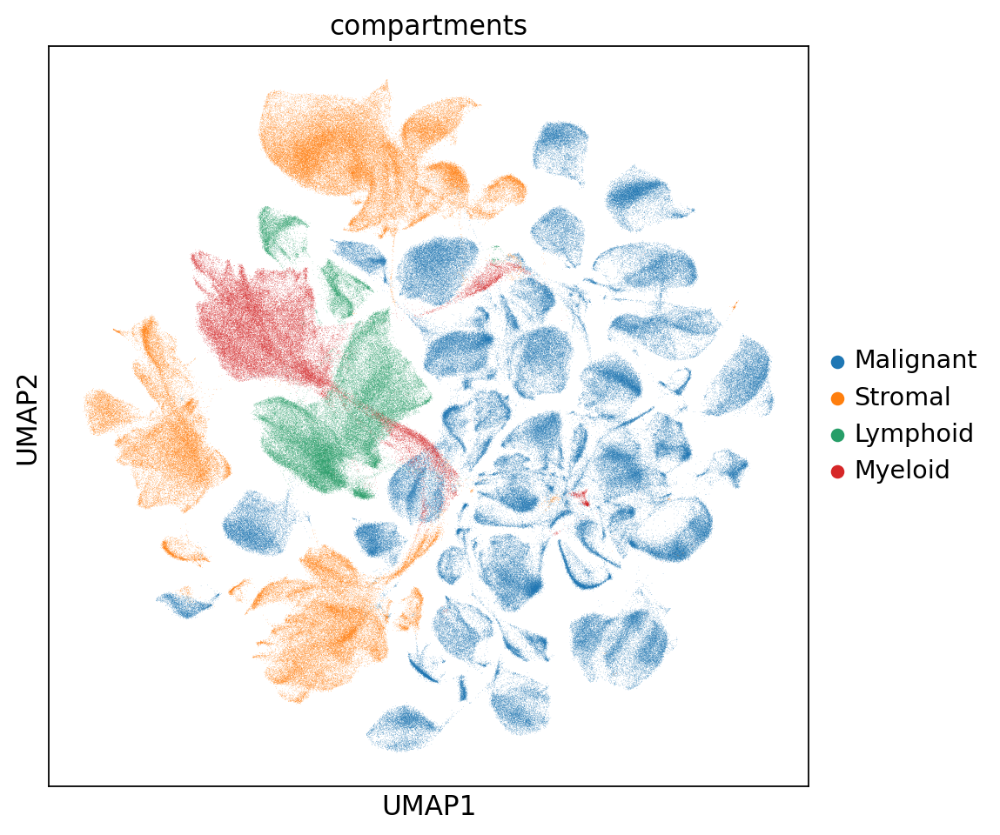

In [93]:
plt.rcParams['figure.figsize'] = [7, 7]
del adata.uns['compartments_colors']
sc.pl.umap(adata, color=['compartments'])

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


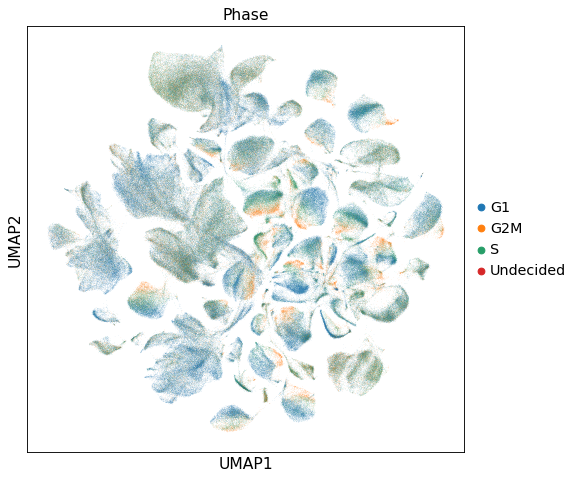

In [13]:
plt.rcParams['figure.figsize'] = [7, 7]
sc.pl.umap(adata, color=['Phase'])

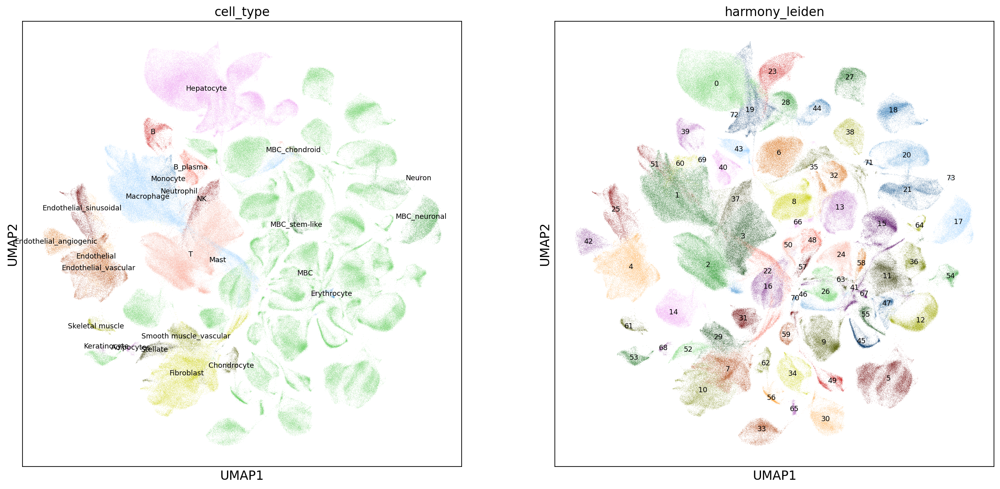

In [11]:
plt.rcParams['figure.figsize'] = [9, 9]
sc.pl.umap(adata, color=['cell_type','harmony_leiden'],palette=colors.values.tolist(),legend_loc='on data',legend_fontweight='normal',legend_fontsize=8)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


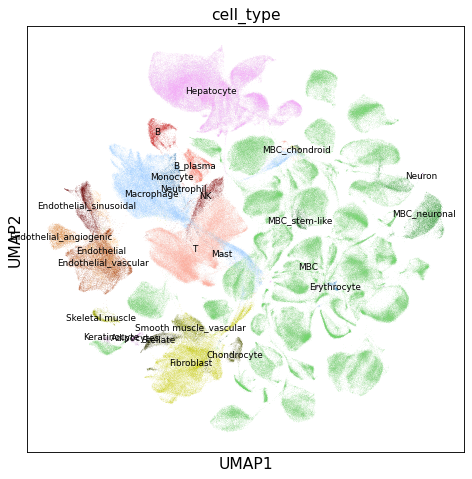

In [14]:
plt.rcParams['figure.figsize'] = [7, 7]
fig=sc.pl.umap(adata, color=['cell_type'],palette=colors.values.tolist(),legend_loc='on data',legend_fontweight='normal',legend_fontsize=8,return_fig=True)
fig.savefig(res_dir+"combined_UMAP_ct_anno"+".pdf",bbox_inches="tight")

### Cell type composition

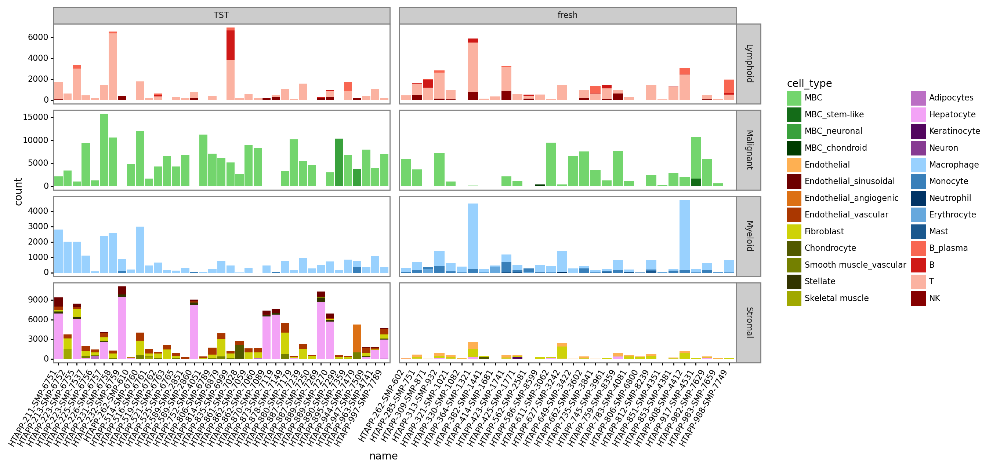

In [37]:
pl=ggplot(adata.obs, aes(x='name',fill='cell_type'))+geom_bar()+rotate_labels()+facet_grid(['compartments','condition'],scales="free")+scale_fill_manual(colors)
pl.draw().set_size_inches(12, 6)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/plotnine/ggplot.py:729: PlotnineWarning: Saving 12 x 3 in image.
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/plotnine/ggplot.py:730: PlotnineWarning: Filename: /scratch/projects/HTAPP_MBC/phase2//analysis/02_combined/combined_ct_composition.pdf


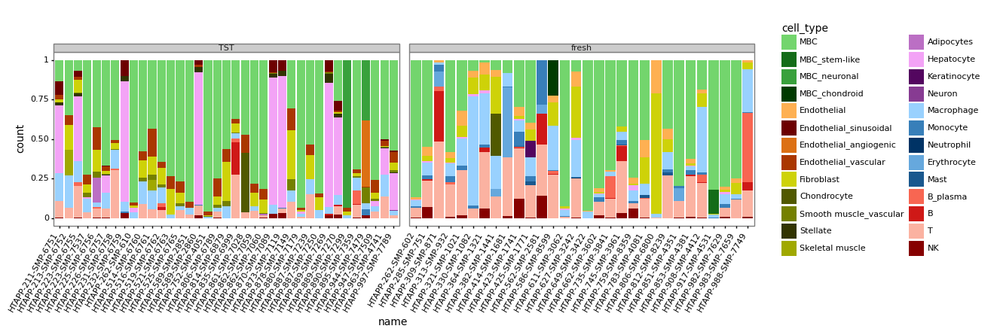

In [31]:
pl=ggplot(adata.obs, aes(x='name',fill='cell_type'))+geom_bar(position="fill")+rotate_labels()+facet_grid('.~condition',space='free',scales='free_x')+scale_fill_manual(colors)
pl.draw().set_size_inches(12, 3)
pl.save(res_dir+"combined_ct_composition"+".pdf",height=3, width=12)

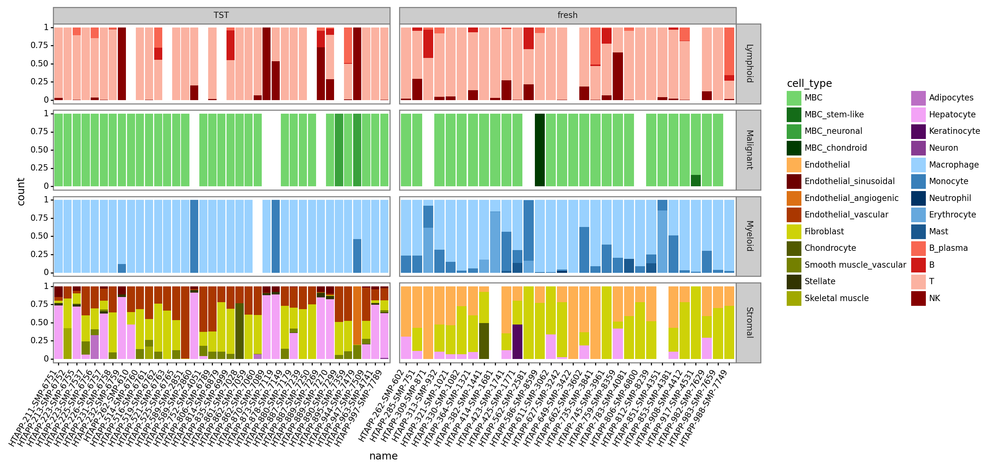

In [38]:
pl=ggplot(adata.obs, aes(x='name',fill='cell_type'))+geom_bar(position="fill")+rotate_labels()+facet_grid(['compartments','condition'],scales="free")+scale_fill_manual(colors)
pl.draw().set_size_inches(12, 6)

In [25]:
samples=pd.Series(adata.obs['name'].unique().astype(str))
split_df=samples.str.split("-",expand=True).set_index(samples)
split_df["vc"]=split_df[1].map(split_df[1].value_counts())

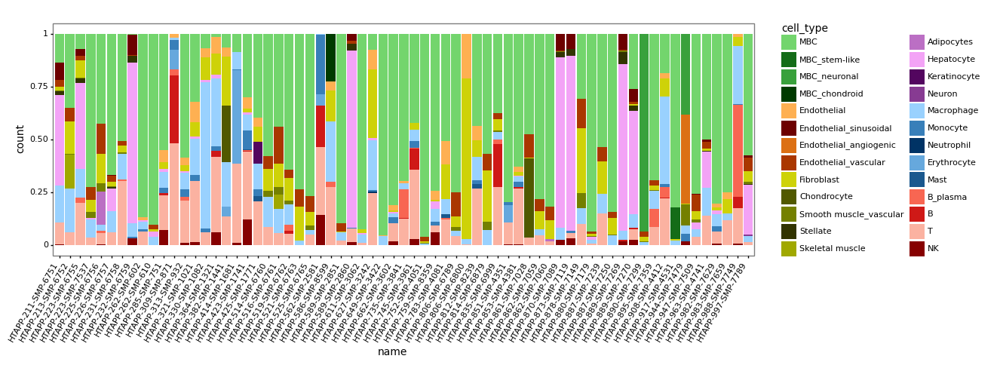

In [57]:
pl=ggplot(adata.obs, aes(x='name',fill='cell_type'))+geom_bar(position="fill")+rotate_labels()+scale_fill_manual(colors)
pl.draw().set_size_inches(12, 4)

In [26]:
obs_dupl=adata.obs[adata.obs.name.isin(split_df[split_df.vc==2].index)].copy()

In [27]:
obs_dupl.name=obs_dupl.name.astype(str).astype("category")
obs_dupl.cell_type=obs_dupl.cell_type.astype(str).astype(pd.CategoricalDtype(colors.index[colors.index.isin(obs_dupl.cell_type)], ordered=True))
obs_dupl["patient"]=obs_dupl["name"].str.rsplit("-",2,expand=True)[0]

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/plotnine/ggplot.py:729: PlotnineWarning: Saving 6.5 x 4 in image.
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/plotnine/ggplot.py:730: PlotnineWarning: Filename: /scratch/projects/HTAPP_MBC/phase2//analysis/02_combined/combined_ct_composition_pairs.pdf


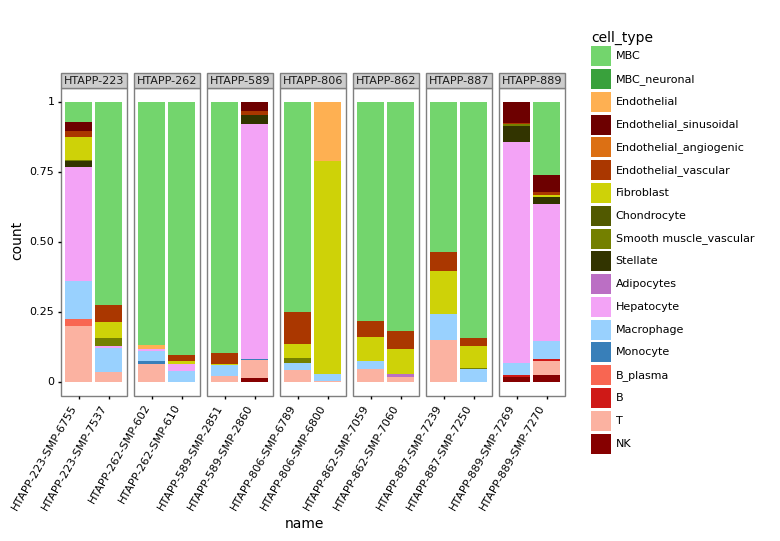

In [30]:
pl=ggplot(obs_dupl, aes(x='name',fill='cell_type'))+geom_bar(position="fill")+rotate_labels()+facet_wrap('patient',scales="free_x",nrow=1)+scale_fill_manual(dict(colors))
pl.draw().set_size_inches(6.5, 4)
pl.save(res_dir+"combined_ct_composition_pairs"+".pdf",height=4, width=6.5)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/plotnine/ggplot.py:729: PlotnineWarning: Saving 6 x 4 in image.
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/plotnine/ggplot.py:730: PlotnineWarning: Filename: /scratch/projects/HTAPP_MBC/phase2//analysis/02_combined/combined_ct_composition_sites.pdf


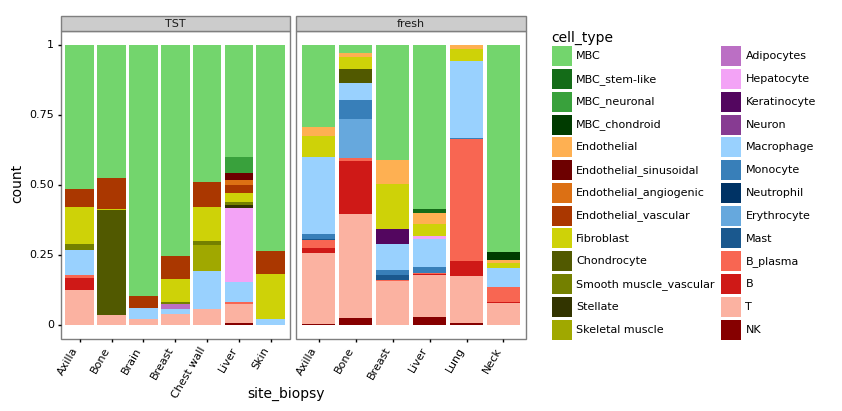

In [32]:
pl=ggplot(adata.obs, aes(x='site_biopsy',fill='cell_type'))+geom_bar(position="fill")+rotate_labels()+scale_fill_manual(colors)+facet_wrap('condition',scales="free_x")
pl.draw().set_size_inches(6, 4)
pl.save(res_dir+"combined_ct_composition_sites"+".pdf",height=4, width=6)

In [7]:
#simplify receptors
adata.obs["receptors_biopsy_simpl"]=""
adata.obs.loc[adata.obs.eval('(ER_biopsy=="Positive" | PR_biopsy=="Positive"|ER_biopsy=="Low" | PR_biopsy=="Low") & HER2_biopsy=="Positive"'),"receptors_biopsy_simpl"] = 'HR+/HER2+'
adata.obs.loc[adata.obs.eval('(ER_biopsy=="Positive" | PR_biopsy=="Positive"|ER_biopsy=="Low" | PR_biopsy=="Low") & HER2_biopsy=="Negative"'),"receptors_biopsy_simpl"] = 'HR+/HER2-'
adata.obs.loc[adata.obs.eval('(ER_biopsy=="Negative" & PR_biopsy=="Negative") & HER2_biopsy=="Positive"'),"receptors_biopsy_simpl"] = 'HR-/HER2+'
adata.obs.loc[adata.obs.eval('(ER_biopsy=="Negative" & PR_biopsy=="Negative") & HER2_biopsy=="Negative"'),"receptors_biopsy_simpl"] = 'HR-/HER2-'

In [22]:
adata.obs["receptors_biopsy_simpl"].value_counts()

HR+/HER2-    337460
HR-/HER2-    154421
HR-/HER2+     35606
HR+/HER2+     21616
               2962
Name: receptors_biopsy_simpl, dtype: int64

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/plotnine/ggplot.py:729: PlotnineWarning: Saving 4 x 4 in image.
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/plotnine/ggplot.py:730: PlotnineWarning: Filename: /scratch/projects/HTAPP_MBC/phase2//analysis/02_combined/combined_ct_composition_receptor.pdf


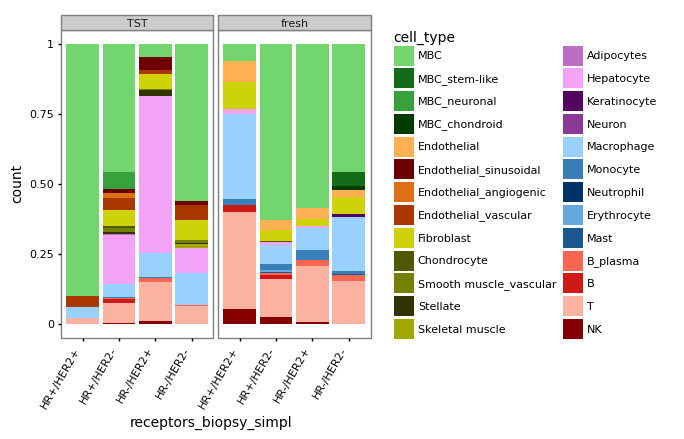

In [34]:
pl=ggplot(adata.obs[adata.obs["receptors_biopsy_simpl"]!=""], aes(x='receptors_biopsy_simpl',fill='cell_type'))+geom_bar(position="fill")+rotate_labels()+scale_fill_manual(colors)+facet_wrap('condition',scales="free_x")
pl.draw().set_size_inches(4, 4)
pl.save(res_dir+"combined_ct_composition_receptor"+".pdf",height=4, width=4)

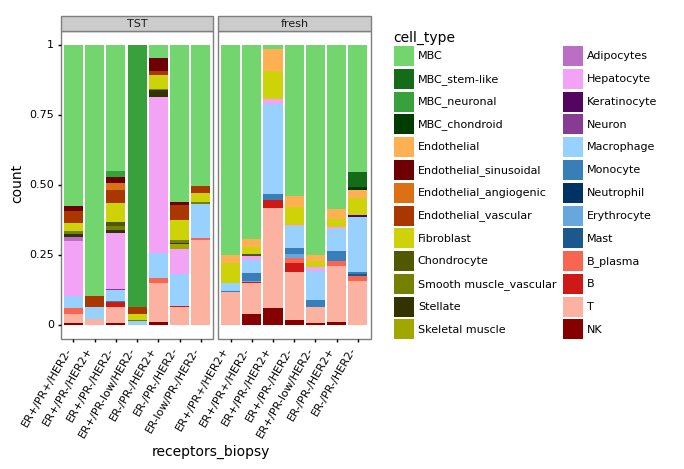

In [28]:
pl=ggplot(adata.obs[adata.obs["receptors_biopsy"]!="nan"], aes(x='receptors_biopsy',fill='cell_type'))+geom_bar(position="fill")+rotate_labels()+scale_fill_manual(colors)+facet_wrap('condition',scales="free_x")
pl.draw().set_size_inches(4, 4)

In [63]:
import matplotlib.colors
name_colors = [matplotlib.colors.to_hex(i) for i in plt.get_cmap('turbo')(np.linspace(0,1,len(adata.obs.name.unique())))]
np.random.default_rng().shuffle(name_colors)

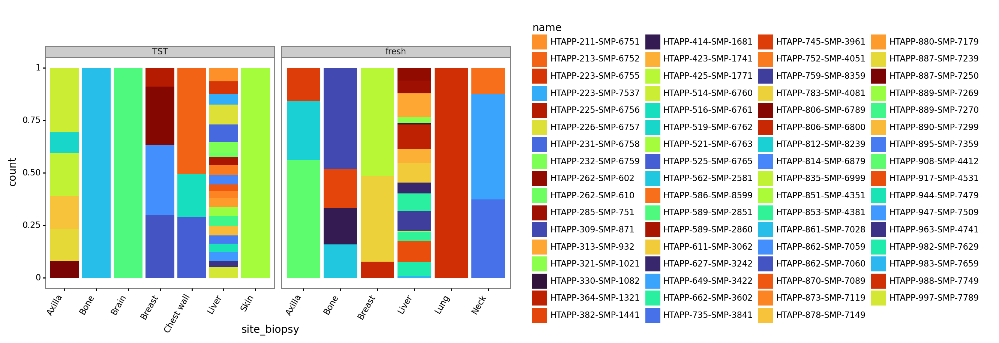

In [64]:
pl=ggplot(adata.obs, aes(x='site_biopsy',fill='name'))+geom_bar(position="fill")+rotate_labels()+facet_wrap('condition',scales="free_x")+scale_fill_manual(name_colors)
pl.draw().set_size_inches(8, 4)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/plotnine/ggplot.py:729: PlotnineWarning: Saving 12 x 3 in image.
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/plotnine/ggplot.py:730: PlotnineWarning: Filename: /scratch/projects/HTAPP_MBC/phase2//analysis/02_combined/combined_compartment_composition.pdf


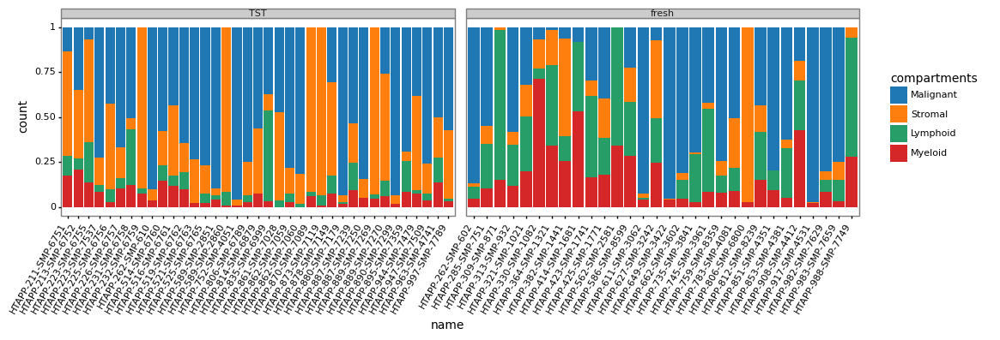

In [35]:
pl=ggplot(adata.obs, aes(x='name',fill='compartments'))+geom_bar(position="fill")+rotate_labels()+facet_wrap('condition',scales="free_x")+scale_fill_manual(adata.uns['compartments_colors'])
pl.draw().set_size_inches(12, 3)
pl.save(res_dir+"combined_compartment_composition"+".pdf",height=3, width=12)

In [21]:
meta_colors={'TST':'grey','fresh':'black','HR+/HER2-':'#255668','HR+/HER2+':'#008C80','HR-/HER2+':'#61C074','HR-/HER2-':'#EDEF5C','Axilla':'#7D1D67','Bone':'#A02074',
 'Brain':'#C22B79','Breast':'#E13C77','Chest wall':'#F65A6D','Liver':'#FD806D','Lung':'#FFA076','Neck':'#FFBD88','Skin':'#FFD99F','':'white'}

In [10]:
sample_meta=adata.obs[["name","receptors_biopsy_simpl","site_biopsy","condition"]].value_counts().to_frame(name="counts").reset_index()
sample_meta['name']=pd.Categorical(sample_meta['name'],categories=sample_meta.sort_values(by=['condition','site_biopsy','receptors_biopsy_simpl'])['name'].unique())
sample_meta=pd.melt(sample_meta, id_vars=["name","counts"])
sample_meta['value']=pd.Categorical(sample_meta['value'],categories=sample_meta.sort_values(by=['variable','value'])['value'].unique())
sample_meta['variable']=pd.Categorical(sample_meta['variable'],categories=['condition','site_biopsy','receptors_biopsy_simpl'])

In [11]:
ct_sample_counts=adata.obs[["name","site_biopsy","receptors_biopsy_simpl","cell_type","condition"]].value_counts().to_frame(name="counts").reset_index()

In [13]:
ct_sample_counts['name']=pd.Categorical(ct_sample_counts['name'],categories=ct_sample_counts.sort_values(by=['condition','site_biopsy','receptors_biopsy_simpl'])['name'].unique())

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/plotnine/ggplot.py:729: PlotnineWarning: Saving 10 x 8 in image.
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/plotnine/ggplot.py:730: PlotnineWarning: Filename: /scratch/projects/HTAPP_MBC/phase2//analysis/02_combined/combined_ct_counts.pdf


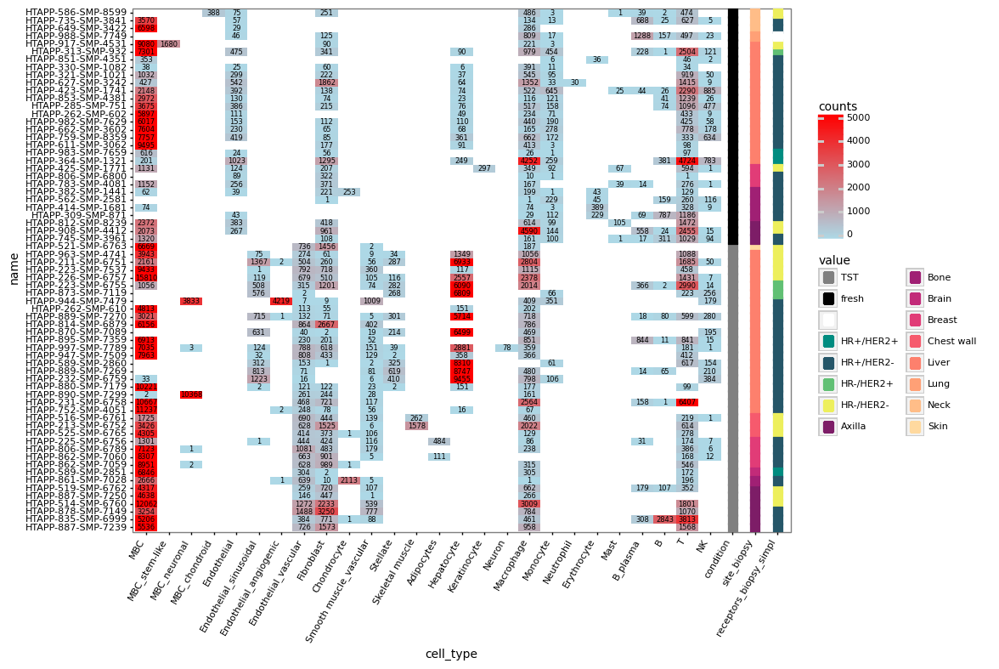

In [22]:
pl=(ggplot(ct_sample_counts, aes(y='name',x='cell_type'))
    + geom_point(sample_meta,aes(y='name',x='variable',color='value'),size=4,shape='s')
    + geom_tile(aes(fill='counts'))
    + geom_text(aes(label='counts'),size=6)
    + rotate_labels()
    + scale_fill_gradient(low="lightblue",high="red",limits=[0,5000])
    + scale_color_manual(values=meta_colors)
    +guides(color=guide_legend(ncol=2)))
pl.draw().set_size_inches(10, 8)
pl.save(res_dir+"combined_ct_counts"+".pdf",height=8, width=10)

In [8]:
meta_colors=["#8c510a","#01665e","#8dd3c7","#ffffb3","#bebada","#fb8072","#80b1d3","#fdb462","#b3de69","#d9d9d9","white","#e41a1c","#377eb8","#4daf4a","#984ea3","#ff7f00","#ffff33","#a65628","#f781bf","grey"]

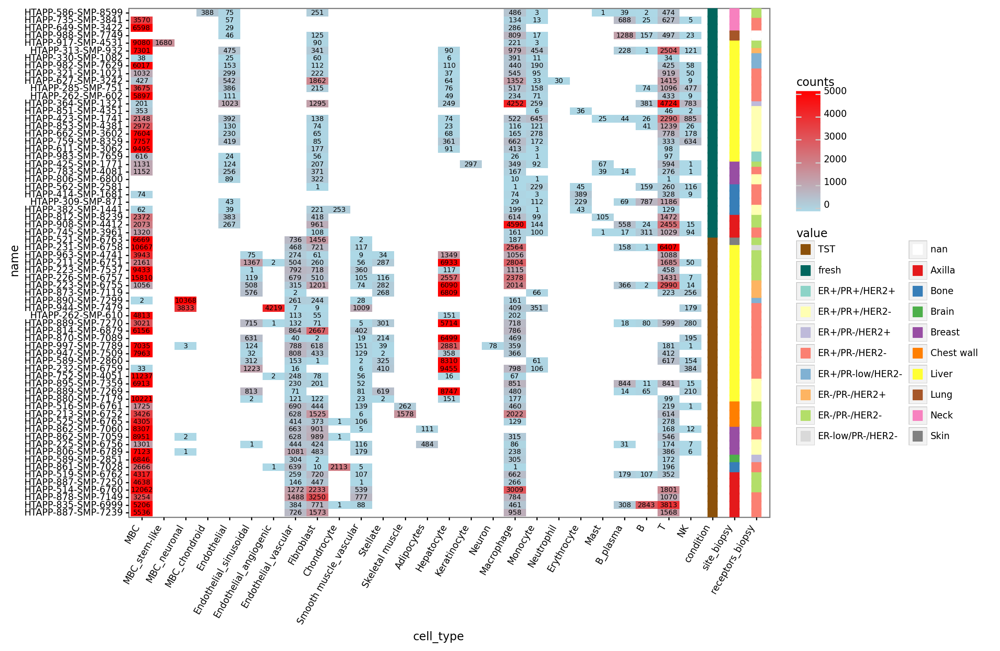

In [35]:
pl=(ggplot(ct_sample_counts, aes(y='name',x='cell_type'))
    + geom_point(sample_meta,aes(y='name',x='variable',color='value'),size=4,shape='s')
    + geom_tile(aes(fill='counts'))
    + geom_text(aes(label='counts'),size=6)
    + rotate_labels()
    + scale_fill_gradient(low="lightblue",high="red",limits=[0,5000])
    + scale_color_manual(values=meta_colors)
    +guides(color=guide_legend(ncol=2)))
pl.draw().set_size_inches(10, 8)
pl.save(res_dir+"combined_ct_composition_receptor"+".pdf",height=8, width=10)

In [8]:
#for samples with spatial data only
sp_sheet=pd.read_csv(codeDir+"/meta/sampletracking_HTAPP_MBC_spatial.csv")

In [12]:
sp_sheet.head()

,sample,replicate,batch,puck,slide_seq_ID
0,HTAPP-944-SMP-7479,1,200213.0,3.0,200213_03
1,HTAPP-944-SMP-7479,2,NaN,NaN,NaN
2,HTAPP-944-SMP-7479,3,NaN,NaN,NaN
3,HTAPP-895-SMP-7359,1,200213.0,5.0,200213_05
4,HTAPP-880-SMP-7179,1,200316.0,5.0,200316_05


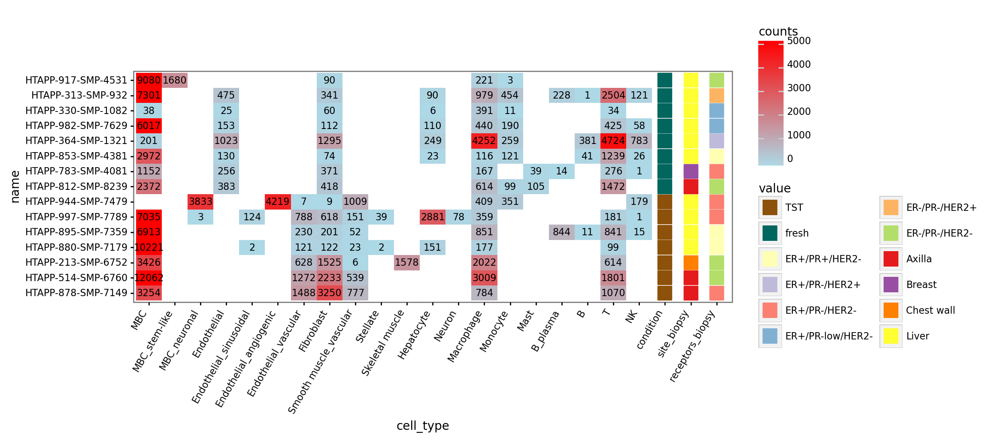

In [52]:
sample_meta_sub=sample_meta.loc[sample_meta["name"].isin(sp_sheet["sample"])].copy()
sample_meta_sub['value']=sample_meta_sub['value'].astype(pd.CategoricalDtype(categories=sample_meta['value'].cat.categories[sample_meta['value'].cat.categories.isin(sample_meta_sub['value'].unique())],ordered=True))
ct_sample_counts_sub=ct_sample_counts.loc[ct_sample_counts["name"].isin(sp_sheet["sample"])]

pl=(ggplot(ct_sample_counts_sub, aes(y='name',x='cell_type'))
    + geom_point(sample_meta_sub,aes(y='name',x='variable',color='value'),size=6,shape='s')
    + geom_tile(aes(fill='counts'))
    + geom_text(aes(label='counts'),size=8)
    + rotate_labels()
    + scale_fill_gradient(low="lightblue",high="red",limits=[0,5000])
    + scale_color_manual(values=np.array(meta_colors)[sample_meta['value'].cat.categories.isin(sample_meta_sub['value'].unique())])
    +guides(color=guide_legend(ncol=2)))
pl.draw().set_size_inches(9, 3.5)

#### pam50

In [18]:
sample_meta=adata.obs[["name","receptors_biopsy","site_biopsy","condition","compartments"]].value_counts().to_frame(name="counts").reset_index()
sample_meta['name']=pd.Categorical(sample_meta['name'],categories=sample_meta.sort_values(by=['condition','receptors_biopsy','site_biopsy'])['name'].unique())
sample_meta=pd.melt(sample_meta, id_vars=["name","counts","compartments"])
sample_meta['value']=pd.Categorical(sample_meta['value'],categories=sample_meta.sort_values(by=['variable','value'])['value'].unique())
sample_meta['variable']=pd.Categorical(sample_meta['variable'],categories=['condition','site_biopsy','receptors_biopsy'])

In [19]:
adata.obs['name']=pd.Categorical(adata.obs['name'],categories=adata.obs.sort_values(by=['condition','receptors_biopsy','site_biopsy'])['name'].unique())

In [8]:
adata.obs.head()

,batch,cell_id,name,condition,replicate,orig.ident,nCount_RNA,nFeature_RNA,percent.mito,RNA_snn_res.0.8,seurat_clusters,labels,labels_score,labels_unif,labels_cl,labels_cl_unif,ccpm,Quality,Order,run status,Note,date,run_pipeline,Channel Name,Lane,Index,cancer,site,reference,chemistry,flowcell,seq_dir,mode,min_umis,min_genes,percent_mito,expected_cells,total_droplets,z_dim,z_layers,channel_id,label_concordance,labels_cl_unif_per_channel,filt_median_genes,filt_median_umi,pass,ccpm_id,ccpm_id_long,sample,htapp,...,cnv_score,cnv_ref_score,cnv_score_norm,cnv_score_norm_norm,cnv_max_cluster,cnv_condition,cnv_mode,cnv_score_norm_norm2,cnv_cell_type,cnv_pass,cnv_pass_mal,pam50_cellid,pam50_Basal_single,pam50_Her2_single,pam50_LumA_single,pam50_LumB_single,pam50_Normal_single,pam50_mode_single,pam50_subtype_single,pam50_subtype_prob_single,pam50_subtype_filt_single,pam50_Basal_cluster,pam50_Her2_cluster,pam50_LumA_cluster,pam50_LumB_cluster,pam50_Normal_cluster,pam50_mode_cluster,pam50_subtype_cluster,pam50_subtype_prob_cluster,pam50_subtype_filt_cluster,S.Score,G2M.Score,Phase,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,n_counts,leiden,leiden_mal,labels_cl_unif2_mal,labels_cl_unif2,labels_cl_unif2_broad,named_cluster,concat,named_cluster_split,compartments,select_cell,cell_type,harmony_leiden
cellid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
HTAPP-225-SMP-6756-TST-channel1_TGCATCCAGTTGCTGT-1-sn,sn,HTAPP-225-SMP-6756-TST-channel1_TGCATCCAGTTGCT...,HTAPP-225-SMP-6756,TST,channel1,HTAPP-225-SMP-6756-TST-channel1,14400,6364,2.847222,20,20,Epithelial cells,0.323041,Epithelial,Epithelial cells,Epithelial,0300260_T2_TST,nan,65,done1,nan,2019_05_28,False,0300260_T2_TST,5,SI-GA-C11,breast,liver,GRCh38_premrna_v3.0.0,SC3Pv3,HY3CLCCXY,/transfer/190522_SL-HYB_0503_BFC...,V3,0,0,60,4000,30000,200,1000,HTAPP-225-SMP-6756_TST_channel1,True,2209,1548.0,2076.0,True,260.0,300260,T2,HTAPP,...,0.002542,0.000932,2.726558,0.471278,Epithelial_1,TST,V3,0.471278,Epithelial,False,False,HTAPP-225-SMP-6756-TST-channel1_TGCATCCAGTTGCT...,0.563223,0.0,0.000000,0.000000,0.436777,single,Basal,0.563223,unknown,0.316631,0.000000,0.082360,0.000000,0.601010,cluster,Normal,0.601010,Normal,-0.023068,-0.027751,G1,6373,14409.0,410.0,2.845444,14347.0,43,56_False,Epithelial,Epithelial,Epithelial,Epithelial_56,Epithelial_Epithelial,Epithelial,Malignant,True,MBC,57
HTAPP-225-SMP-6756-TST-channel1_TGCAGTATCCTGCCAT-1-sn,sn,HTAPP-225-SMP-6756-TST-channel1_TGCAGTATCCTGCC...,HTAPP-225-SMP-6756,TST,channel1,HTAPP-225-SMP-6756-TST-channel1,13243,7599,0.415314,3,3,Adipocytes,0.431238,Adipocytes,Endothelial cells,Endothelial,0300260_T2_TST,nan,65,done1,nan,2019_05_28,False,0300260_T2_TST,5,SI-GA-C11,breast,liver,GRCh38_premrna_v3.0.0,SC3Pv3,HY3CLCCXY,/transfer/190522_SL-HYB_0503_BFC...,V3,0,0,60,4000,30000,200,1000,HTAPP-225-SMP-6756_TST_channel1,False,800,1734.0,2150.0,True,260.0,300260,T2,HTAPP,...,0.000835,0.000932,0.895210,0.154735,Epithelial_1,TST,V3,0.154735,Endothelial,False,False,HTAPP-225-SMP-6756-TST-channel1_TGCAGTATCCTGCC...,0.000000,0.0,0.883686,0.031722,0.084592,single,LumA,0.883686,LumA,0.000000,0.086341,0.450694,0.462965,0.000000,cluster,LumB,0.462965,unknown,-0.036614,-0.058505,G1,7608,13252.0,55.0,0.415032,13177.0,4,3_False,Endothelial,Endothelial,Endothelial,Endothelial_3,Endothelial_Endothelial,Endothelial_3,Stromal,True,Endothelial_vascular,4
HTAPP-225-SMP-6756-TST-channel1_TCACGCTAGCATGTTC-1-sn,sn,HTAPP-225-SMP-6756-TST-channel1_TCACGCTAGCATGT...,HTAPP-225-SMP-6756,TST,channel1,HTAPP-225-SMP-6756-TST-channel1,12393,5916,2.315823,13,13,Epithelial cells,0.325782,Epithelial,Epithelial cells,Epithelial,0300260_T2_TST,nan,65,done1,nan,2019_05_28,False,0300260_T2_TST,5,SI-GA-C11,breast,liver,GRCh38_premrna_v3.0.0,SC3Pv3,HY3CLCCXY,/transfer/190522_SL-HYB_0503_BFC...,V3,0,0,60,4000,30000,200,1000,HTAPP-225-SMP-6756_TST_channel1,True,2209,1548.0,2076.0,True,260.0,300260,T2,HTAPP,...,0.005394,0.00093

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


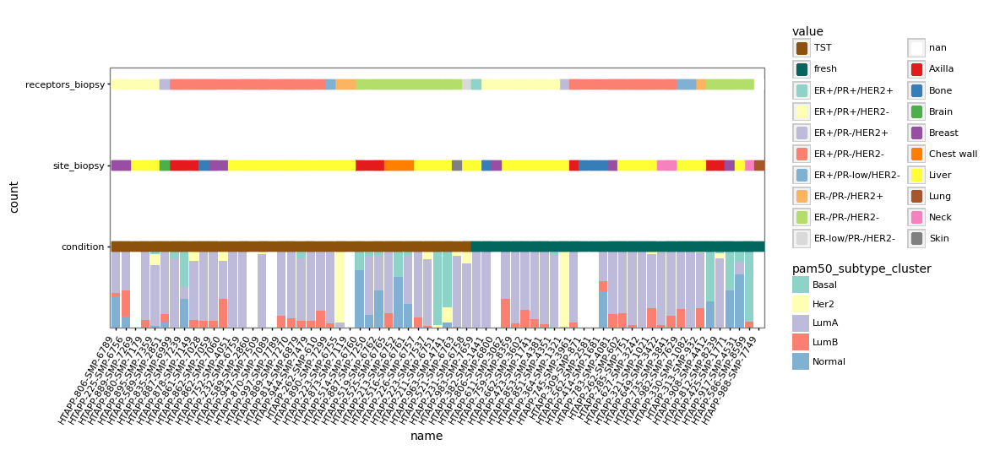

In [27]:
pl=(ggplot(sample_meta.loc[sample_meta["compartments"]=="Malignant",], aes(x='name'))
    + geom_bar(adata[adata.obs.compartments=="Malignant"].obs,aes(fill='pam50_subtype_cluster'),position="fill")
    + geom_point(sample_meta,aes(y='variable',color='value'),size=4,shape='s')
    + scale_color_manual(values=meta_colors)
    + scale_fill_manual(values=["#8dd3c7","#ffffb3","#bebada","#fb8072","#80b1d3","lightgrey"])
    + guides(color=guide_legend(ncol=2))
    + rotate_labels()
    + scale_y_discrete(expand=[0,1,0.1,0]))
pl.draw().set_size_inches(10, 4)

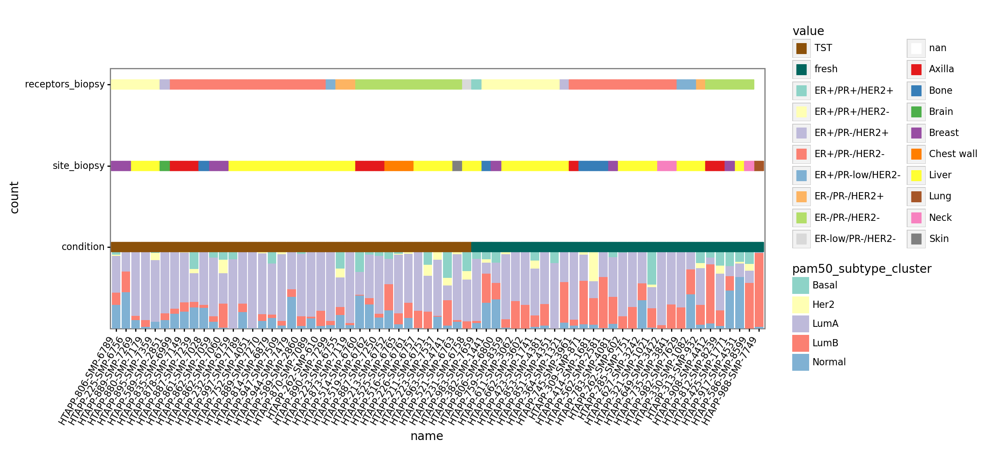

In [9]:
pl=(ggplot(sample_meta, aes(x='name'))
    + geom_bar(adata.obs,aes(fill='pam50_subtype_cluster'),position="fill")
    + geom_point(sample_meta,aes(y='variable',color='value'),size=4,shape='s')
    + scale_color_manual(values=meta_colors)
    + scale_fill_manual(values=["#8dd3c7","#ffffb3","#bebada","#fb8072","#80b1d3","lightgrey"])
    + guides(color=guide_legend(ncol=2))
    + rotate_labels()
    + scale_y_discrete(expand=[0,1,0.1,0]))
pl.draw().set_size_inches(10, 4)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


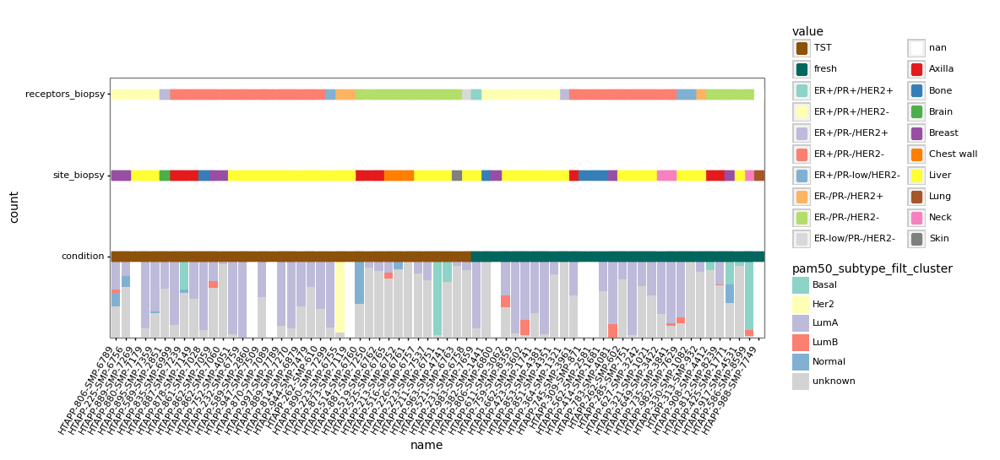

In [28]:
pl=(ggplot(sample_meta.loc[sample_meta["compartments"]=="Malignant",], aes(x='name'))
    + geom_bar(adata[adata.obs.compartments=="Malignant"].obs,aes(fill='pam50_subtype_filt_cluster'),position="fill")
    + geom_point(sample_meta,aes(y='variable',color='value'),size=4,shape='s')
    + scale_color_manual(values=meta_colors)
    + scale_fill_manual(values=["#8dd3c7","#ffffb3","#bebada","#fb8072","#80b1d3","lightgrey"])
    + guides(color=guide_legend(ncol=2))
    + rotate_labels()
    + scale_y_discrete(expand=[0,1,0.1,0]))
pl.draw().set_size_inches(10, 4)

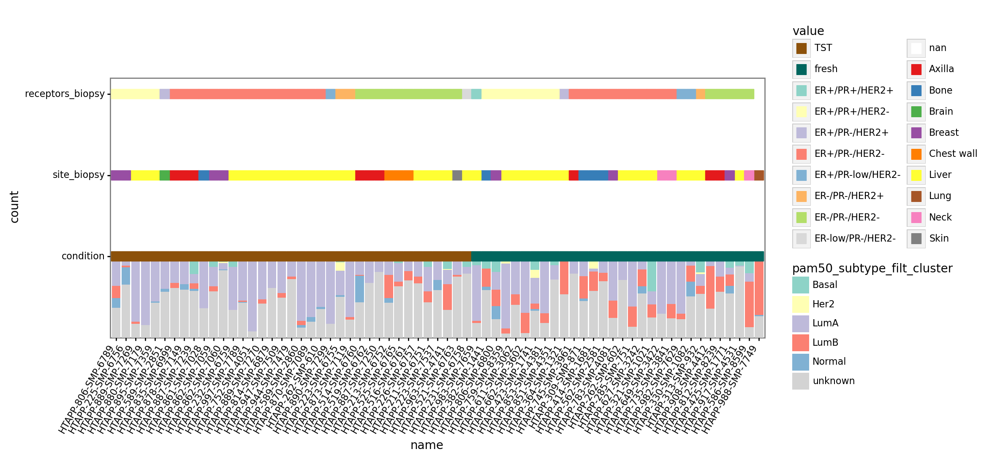

In [91]:
pl=(ggplot(sample_meta, aes(x='name'))
    + geom_bar(adata.obs,aes(fill='pam50_subtype_filt_cluster'),position="fill")
    + geom_point(sample_meta,aes(y='variable',color='value'),size=4,shape='s')
    + scale_color_manual(values=meta_colors)
    + scale_fill_manual(values=["#8dd3c7","#ffffb3","#bebada","#fb8072","#80b1d3","lightgrey"])
    + guides(color=guide_legend(ncol=2))
    + rotate_labels()
    + scale_y_discrete(expand=[0,1,0.1,0]))
pl.draw().set_size_inches(10, 4)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


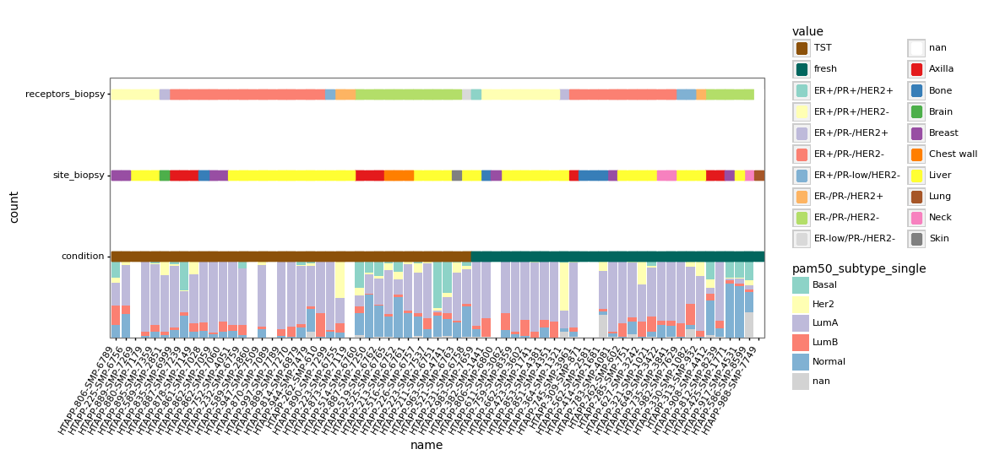

In [29]:
pl=(ggplot(sample_meta.loc[sample_meta["compartments"]=="Malignant",], aes(x='name'))
    + geom_bar(adata[adata.obs.compartments=="Malignant"].obs,aes(fill='pam50_subtype_single'),position="fill")
    + geom_point(sample_meta,aes(y='variable',color='value'),size=4,shape='s')
    + scale_color_manual(values=meta_colors)
    + scale_fill_manual(values=["#8dd3c7","#ffffb3","#bebada","#fb8072","#80b1d3","lightgrey"])
    + guides(color=guide_legend(ncol=2))
    + rotate_labels()
    + scale_y_discrete(expand=[0,1,0.1,0]))
pl.draw().set_size_inches(10, 4)

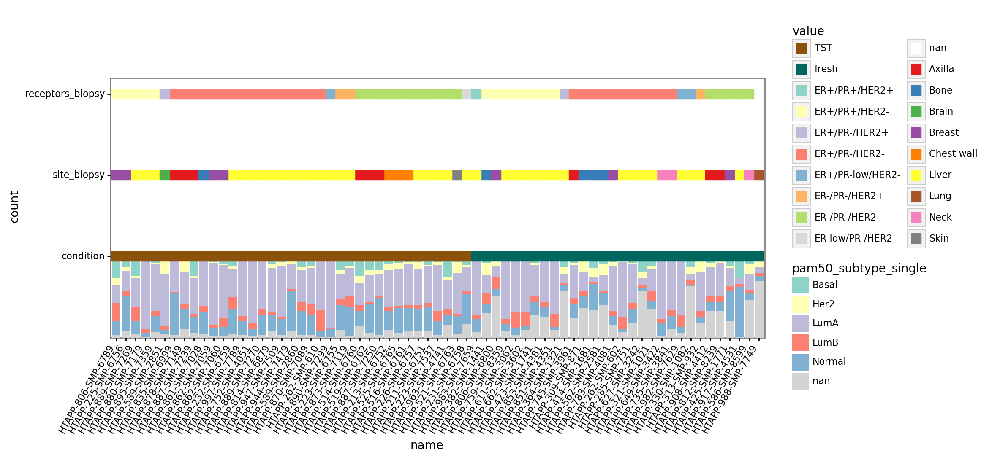

In [10]:
pl=(ggplot(sample_meta, aes(x='name'))
    + geom_bar(adata.obs,aes(fill='pam50_subtype_single'),position="fill")
    + geom_point(sample_meta,aes(y='variable',color='value'),size=4,shape='s')
    + scale_color_manual(values=meta_colors)
    + scale_fill_manual(values=["#8dd3c7","#ffffb3","#bebada","#fb8072","#80b1d3","lightgrey"])
    + guides(color=guide_legend(ncol=2))
    + rotate_labels()
    +scale_y_discrete(expand=[0,1,0.1,0]))
pl.draw().set_size_inches(10, 4)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


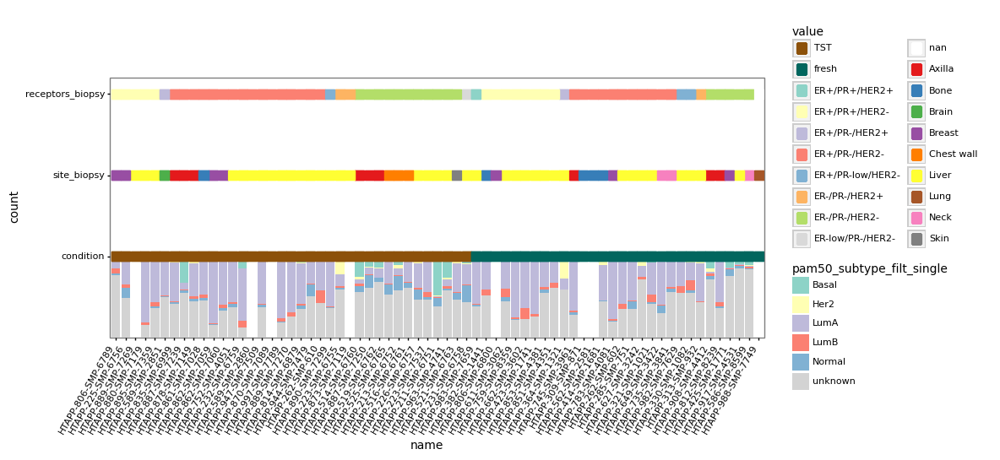

In [30]:
pl=(ggplot(sample_meta.loc[sample_meta["compartments"]=="Malignant",], aes(x='name'))
    + geom_bar(adata[adata.obs.compartments=="Malignant"].obs,aes(fill='pam50_subtype_filt_single'),position="fill")
    + geom_point(sample_meta,aes(y='variable',color='value'),size=4,shape='s')
    + scale_color_manual(values=meta_colors)
    + scale_fill_manual(values=["#8dd3c7","#ffffb3","#bebada","#fb8072","#80b1d3","lightgrey"])
    + guides(color=guide_legend(ncol=2))
    + rotate_labels()
    + scale_y_discrete(expand=[0,1,0.1,0]))
pl.draw().set_size_inches(10, 4)

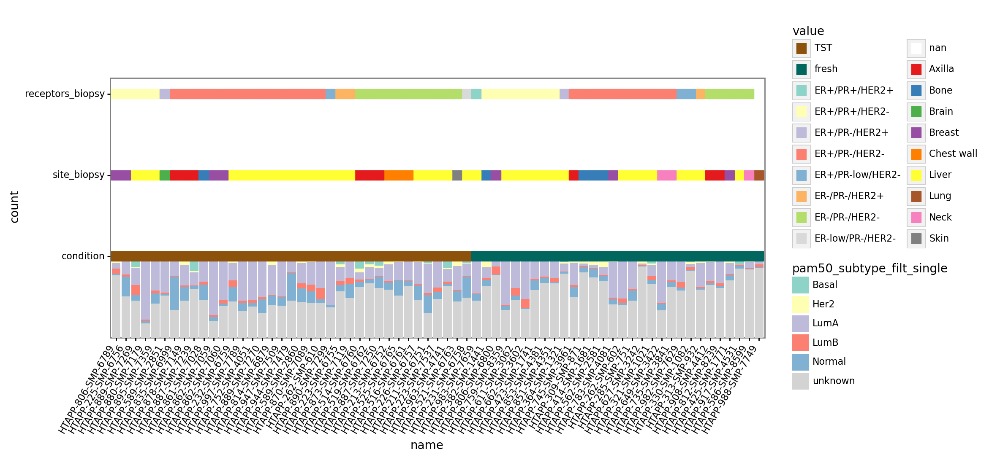

In [90]:
pl=(ggplot(sample_meta, aes(x='name'))
    + geom_bar(adata.obs,aes(fill='pam50_subtype_filt_single'),position="fill")
    + geom_point(sample_meta,aes(y='variable',color='value'),size=4,shape='s')
    + scale_color_manual(values=meta_colors)
    + scale_fill_manual(values=["#8dd3c7","#ffffb3","#bebada","#fb8072","#80b1d3","lightgrey"])
    + guides(color=guide_legend(ncol=2))
    + rotate_labels()
    +scale_y_discrete(expand=[0,1,0.1,0]))
pl.draw().set_size_inches(10, 4)

### Follow-up

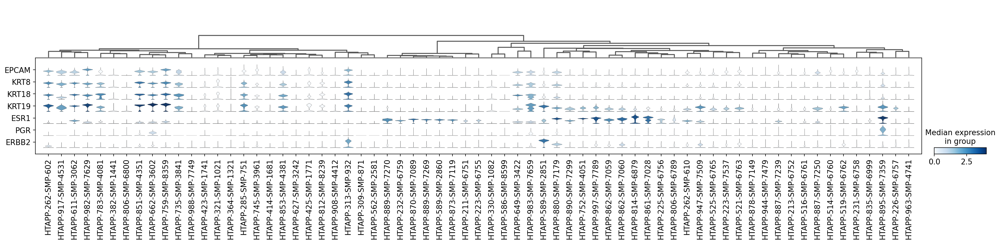

In [67]:
sc.pl.stacked_violin(adata, ["EPCAM","KRT8","KRT18","KRT19","ESR1","PGR","ERBB2"], groupby='name', dendrogram=True,swap_axes=True)

In [ ]:
adata_mal=adata[adata.obs.compartments=="Malignant"].copy()

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


In [14]:
sc.tl.dendrogram(adata_mal,var_names=["ESR1","PGR","ERBB2"],groupby='name',key_added='dendrogram_name')

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


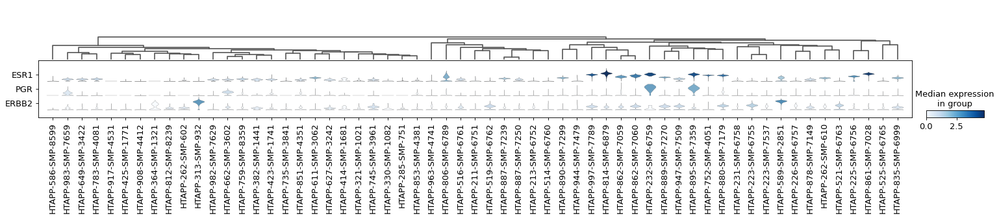

In [21]:
sc.pl.stacked_violin(adata_mal, ["ESR1","PGR","ERBB2"], groupby='name', dendrogram=True,swap_axes=True)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


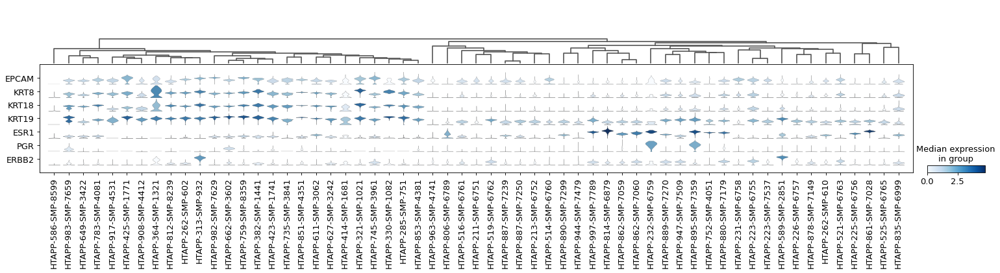

In [17]:
sc.pl.stacked_violin(adata_mal, ["EPCAM","KRT8","KRT18","KRT19","ESR1","PGR","ERBB2"], groupby='name', dendrogram=True,swap_axes=True,return_fig=True)

In [24]:
rest_thres=0.2
de_info=get_sub_markers(adata_mal,list(adata_mal.obs.name.dtype.categories),'name',mode="info")
markers=de_info[de_info.pts_rest<rest_thres].groupby('type').apply(lambda x: x['names'][:5])
markers=dict(iter(markers.reset_index().groupby('type')['names']))

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


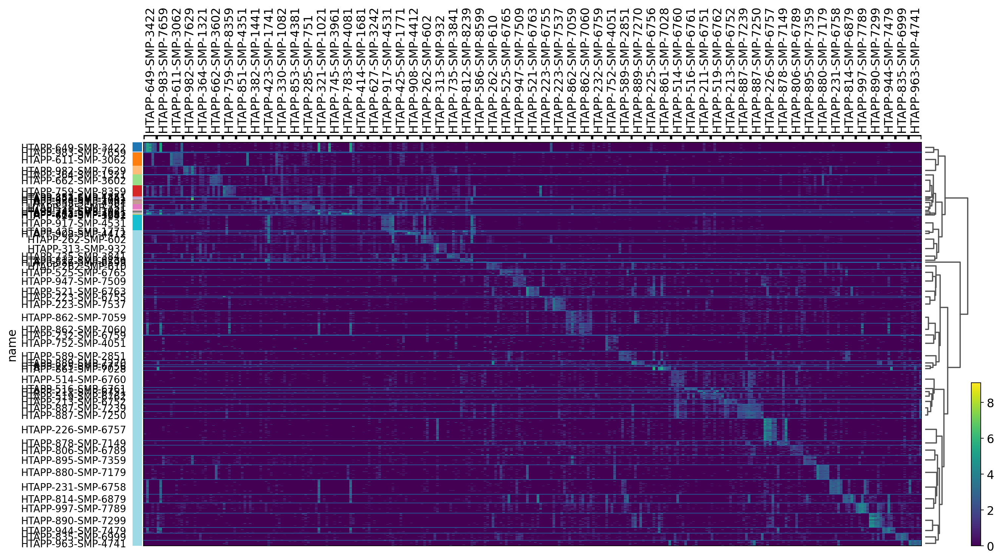

In [28]:
sc.pl.heatmap(adata_mal, markers, groupby='name',figsize=[18,9], dendrogram=True)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


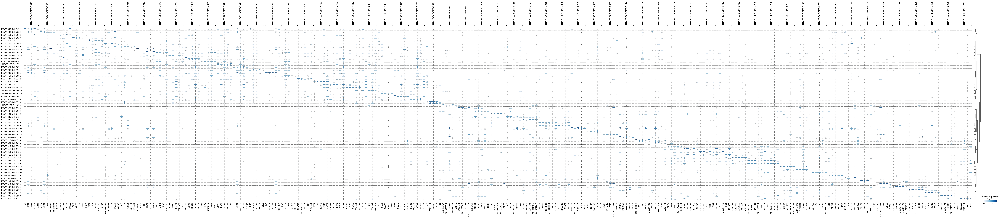

In [25]:
sc.pl.stacked_violin(adata_mal, markers, groupby='name', dendrogram=True,standard_scale='var')

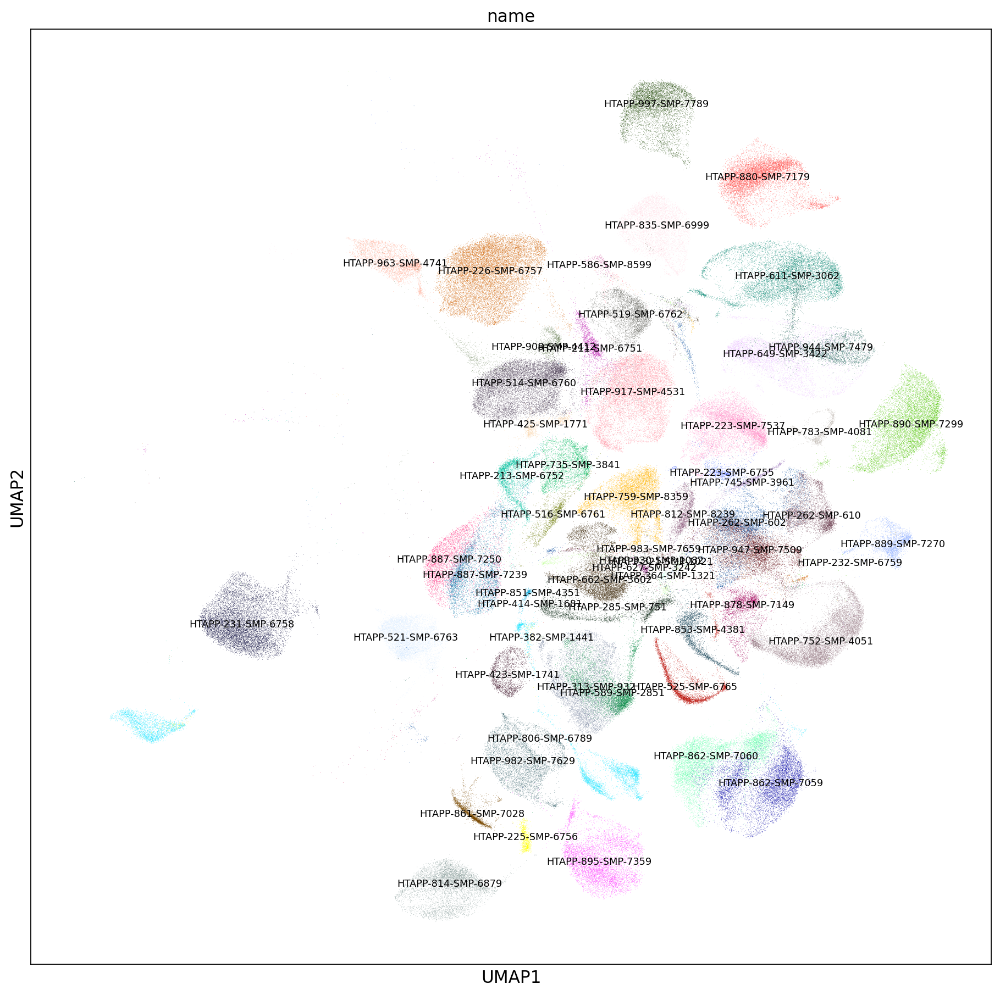

In [126]:
plt.rcParams['figure.figsize'] = [14, 14]
sc.pl.umap(adata_mal, color=['name'],legend_loc='on data',legend_fontweight='normal',legend_fontsize=8)